In [1]:
import pandas as pd
import numpy as np
from pynm.pynm import PyNM
import seaborn as sns
import matplotlib.pyplot as plt

import patsy as pat
import statsmodels.api as sm

This notebook demonstrates the usage of the approximate GP model using a large dataset.

## **Generate data**

In [2]:
def model(age, sex, offset):
    noise = np.random.normal(0, 0.1)
    return 0.001*age-0.00001*(age-50)**2+0.5 + noise - np.random.uniform(0, 0.3) * sex + offset


def model_prob(age, sex, offset):
    noise = np.random.normal(0, 0.1)
    return 0.001*age-0.00001*(age-50)**2+0.5 + noise - np.random.uniform(0, 0.3) * sex - 0.2 * np.random.uniform() + offset

def generate_data(group='PROB_CON', sample_size=1, n_sites=2, randseed=3):
    np.random.seed(randseed)
    n_sites = n_sites
    age_min = (np.random.rand(n_sites)*50).astype(int)
    sites = pd.DataFrame(data={'sex_ratio': np.random.rand(n_sites),
                               'prob_ratio': 0.5*np.random.rand(n_sites),
                               'age_min': age_min,
                               'age_max': (age_min+5+np.random.rand(n_sites)*50).astype(int),
                               'score_shift': np.random.randn(n_sites)/4,
                               'sample_size': (sample_size+np.random.rand(n_sites)*sample_size*10).astype(int)})

    participants = []
    for site in sites.iterrows():
        for participant in range(int(site[1]['sample_size'])):
            sex = np.random.binomial(1, site[1]['sex_ratio'])
            prob = np.random.binomial(1, site[1]['prob_ratio'])
            age = np.random.uniform(site[1]['age_min'], site[1]['age_max'])
            if prob:
                score = model_prob(age, sex, site[1]['score_shift'])
            else:
                score = model(age, sex, site[1]['score_shift'])
            participants.append([site[0], sex, prob, age, score])

    df = pd.DataFrame(participants, columns=['site', 'sex', 'group', 'age', 'score'])
    df.sex.replace({1: 'Female', 0: 'Male'}, inplace=True)
    if group == 'PROB_CON':
        df.group.replace({1: 'PROB', 0: 'CTR'}, inplace=True)
    return df

In [7]:
df = generate_data(n_sites=3,sample_size=300,randseed=100)
print('n subjects = {}'.format(df.shape[0]))

n subjects = 7467


## **Visualize data**
### By site

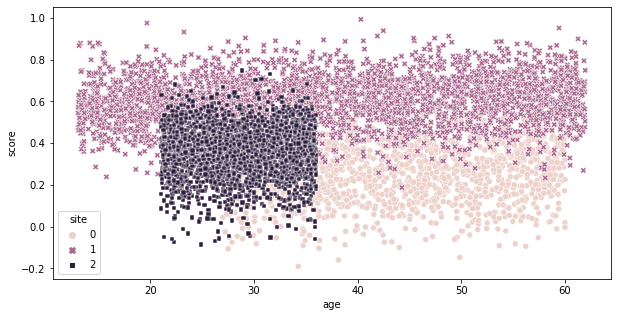

In [8]:
plt.figure(figsize=(10,5))
sns.scatterplot(data=df, x='age', y='score', hue='site', style='site')
plt.show()

### By PROB vs CTR

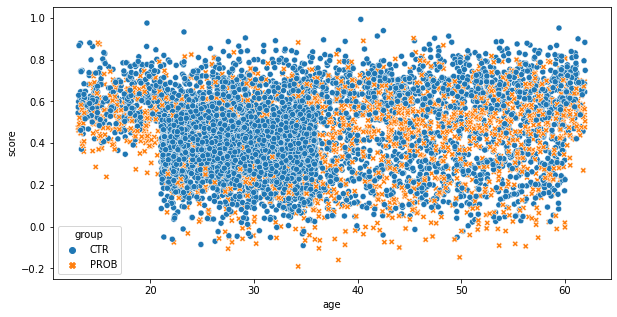

In [9]:
plt.figure(figsize=(10,5))
sns.scatterplot(data=df, x='age', y='score', hue='group', style='group')
plt.show()

## **PyNM - Normative Modeling**

In [10]:
#Initialize pynm w/ data and confounds
m = PyNM(df,'score','group',
            confounds = ['age','C(sex)','C(site)']) #multivarite confounds for GP model

Fitting model on full set of controls...


In [11]:
#Run model
gp = m.gp_normative_model()

#Collect output
data = m.data

oss=-.278]
Epoch: 100%|██████████| 20/20 [00:42<00:00,  2.11s/it]


## **Visualize Normative Models**

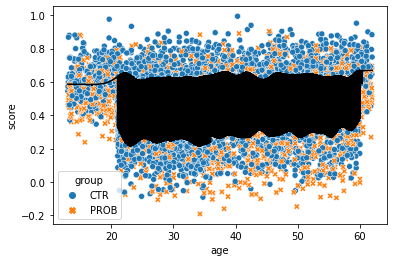

In [12]:
m.plot(plot_type='GP')

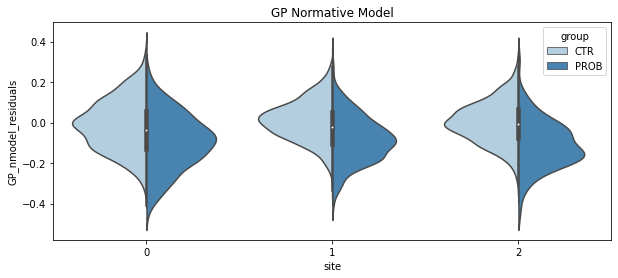

In [13]:
plt.figure(figsize=(10,4))
sns.violinplot(x='site',y='GP_nmodel_residuals',data=data,split=True,palette='Blues',hue='group')
plt.title('GP Normative Model')
plt.show()

## **Corrected scores**
Using GP model (age, sex, site confounds)

Text(0.5, 1.0, 'Corrected')

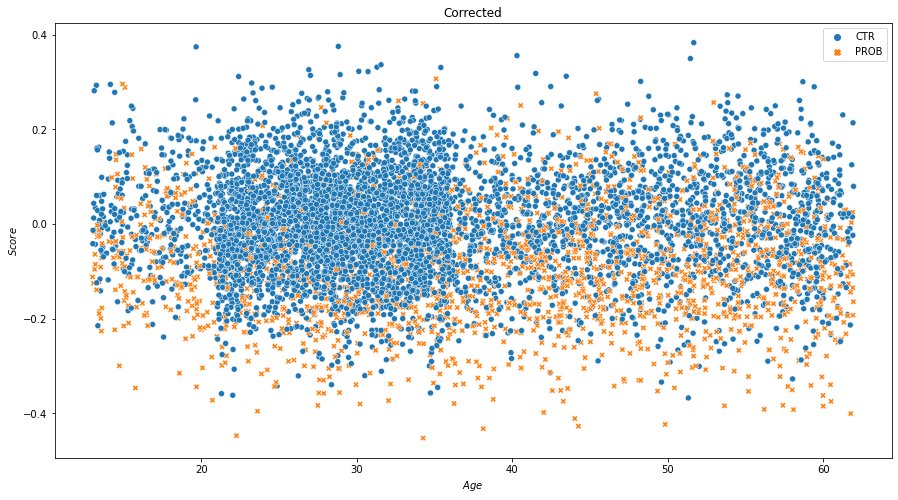

In [14]:
plt.figure(figsize=(15,8))
sns.scatterplot(data=data,x='age', y='GP_nmodel_residuals',hue='group',style='group')

plt.xlabel('$Age$')
plt.ylabel('$Score$')
plt.legend(loc='upper right')
plt.title('Corrected')

Text(0.5, 1.0, 'Uncorrected')

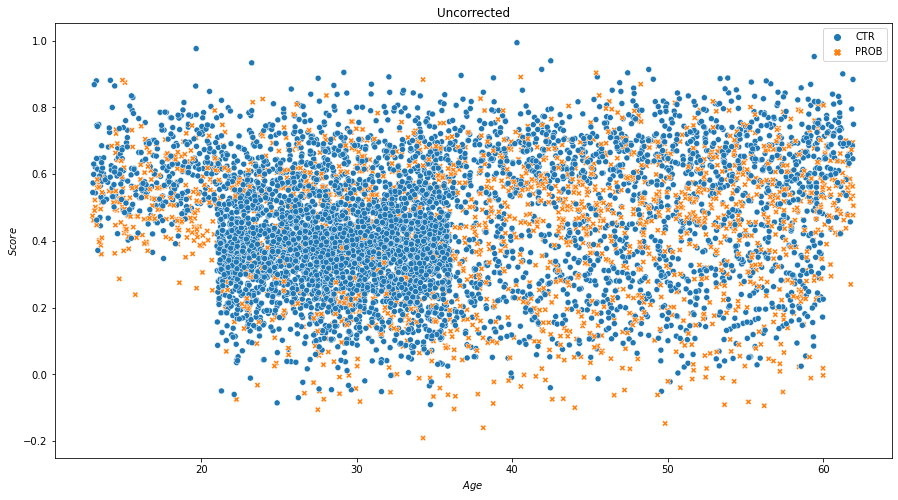

In [15]:
plt.figure(figsize=(15,8))
sns.scatterplot(data=data,x='age', y='score',hue='group',style='group')

plt.xlabel('$Age$')
plt.ylabel('$Score$')
plt.legend(loc='upper right')
plt.title('Uncorrected')

## **Case-control**
Corrected vs uncorrected scores

In [19]:
dmat = pat.dmatrix('C(group)', m.data, return_type='dataframe',NA_action='raise')
    
mod = sm.OLS(m.data['score'],dmat)
results = mod.fit()

print('Uncorrected')
print('p-val case-control difference: ',np.round(results.pvalues[1],4))

Uncorrected
p-val case-control difference:  0.2869


In [21]:
mod = sm.OLS(m.data['GP_nmodel_residuals'],dmat)
results = mod.fit()

print('Corrected')
print('p-val case-control difference: ',results.pvalues[1])

Corrected
p-val case-control difference:  4.4208472394268355e-197
